<a href="https://colab.research.google.com/github/mihirn07/CS726_project/blob/main/WGAN_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Loading Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import torch
import torch.nn as nn
from torch.nn import init
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim
import torch.utils.data as data
from torch.utils.data import DataLoader
from torch.nn.parallel import DistributedDataParallel as DDP
from torch.utils.data.distributed import DistributedSampler
from torch.utils.data import sampler
import torchvision.datasets as dset
from torch.autograd import Variable

import os
import time
from google.colab.patches import cv2_imshow
import pickle
import cv2
import numpy as np
import glob
from PIL import Image
import shutil

from skimage.color import rgb2lab, lab2rgb, rgb2gray, xyz2lab
from skimage.io import imsave

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from torchsummary import summary

from itertools import product
from math import sqrt

dtype = torch.cuda.FloatTensor
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available()==False:
  dtype=torch.FloatTensor
print(device,dtype)

cuda <class 'torch.cuda.FloatTensor'>


##Setting Model Configuration

In [23]:
class set_config:

  def __init__(self):
    self.cuda=torch.cuda.is_available()
    self.weight_decay=0.1 #set
    self.lr=4e-4 #set
    self.test_img_name=None #set
    self.batch_size=20 #set
    self.mode='train'
    self.resume = False

    try:
      self.save_path=glob.glob('/content/drive/MyDrive/CS726_proj/weights/*')[0]
    except:
      self.save_path=glob.glob('/content/drive/MyDrive/CS726_proj/weights/*')

    self.dir='/content/drive/MyDrive/CS726_proj/'
    self.lamb=100
    self.epoch = 10
    self.lambd = 10

config=set_config()
print(config.save_path)

/content/drive/MyDrive/CS726_proj/weights/latest_colorize_weights_9.pth.tar


##Generator Module

In [11]:
class Generator(nn.Module):

    def __init__(self):
      super(Generator,self).__init__()
      self.conv1=nn.Conv2d(1,64,3,stride=1,padding=1,bias=False)
      self.relu1=nn.LeakyReLU(0.2)

      self.conv2=nn.Conv2d(64,64,3,stride=2,padding=1,bias=False)
      self.bn2=nn.BatchNorm2d(64,momentum=0.5)
      self.relu2=nn.LeakyReLU(0.2)
      
      self.conv3=nn.Conv2d(64,128,3,stride=2,padding=1,bias=False)
      self.bn3=nn.BatchNorm2d(128,momentum=0.5)
      self.relu3=nn.LeakyReLU(0.2)

      self.conv4=nn.Conv2d(128,256,3,stride=2,padding=1,bias=False)
      self.bn4=nn.BatchNorm2d(256,momentum=0.5)
      self.relu4=nn.LeakyReLU(0.2)

      self.conv5=nn.Conv2d(256,512,3,stride=2,padding=1,bias=False)
      self.bn5=nn.BatchNorm2d(512,momentum=0.5)
      self.relu5=nn.LeakyReLU(0.2)

      self.conv6=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn6=nn.BatchNorm2d(512,momentum=0.5)
      self.relu6=nn.LeakyReLU(0.2)

      self.conv7=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn7=nn.BatchNorm2d(512,momentum=0.5)
      self.relu7=nn.LeakyReLU(0.2)

      self.conv8=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn8=nn.BatchNorm2d(512,momentum=0.5)
      self.relu8=nn.LeakyReLU(0.2)

      self.conv9=nn.ConvTranspose2d(512,512,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn9=nn.BatchNorm2d(512,momentum=0.5)
      self.relu9=nn.ReLU()
      
      self.conv10=nn.ConvTranspose2d(1024,512,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn10=nn.BatchNorm2d(512,momentum=0.5)
      self.relu10=nn.ReLU()

      self.conv11=nn.ConvTranspose2d(1024,512,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn11=nn.BatchNorm2d(512,momentum=0.5)
      self.relu11=nn.ReLU()

      self.conv12=nn.ConvTranspose2d(1024,256,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn12=nn.BatchNorm2d(256,momentum=0.5)
      self.relu12=nn.ReLU()

      self.conv13=nn.ConvTranspose2d(512,128,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn13=nn.BatchNorm2d(128,momentum=0.5)
      self.relu13=nn.ReLU()

      self.conv14=nn.ConvTranspose2d(256,64,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn14=nn.BatchNorm2d(64,momentum=0.5)
      self.relu14=nn.ReLU()

      self.conv15=nn.ConvTranspose2d(128,64,3,stride=2,padding=1,output_padding=1,bias=False)
      self.bn15=nn.BatchNorm2d(64,momentum=0.5)
      self.relu15=nn.ReLU()
      
      self.conv16=nn.Conv2d(128,3,1,stride=1,bias=False)

    def forward(self,img):
      
      x1=self.relu1(self.conv1(img))

      x2=self.relu2(self.bn2(self.conv2(x1)))

      x3=self.relu3(self.bn3(self.conv3(x2)))

      x4=self.relu4(self.bn4(self.conv4(x3)))

      x5=self.relu5(self.bn5(self.conv5(x4)))

      x6=self.relu6(self.bn6(self.conv6(x5)))

      x7=self.relu7(self.bn7(self.conv7(x6)))

      x8=self.relu8(self.bn8(self.conv8(x7)))

      x9=self.relu9(self.bn9(self.conv9(x8)))
      x9=torch.cat([x7,x9],1)

      x10=self.relu10(self.bn10(self.conv10(x9)))
      x10=torch.cat([x6,x10],1)

      x11=self.relu11(self.bn11(self.conv11(x10)))
      x11=torch.cat([x5,x11],1)

      x12=self.relu12(self.bn12(self.conv12(x11)))
      x12=torch.cat([x4,x12],1)

      x13=self.relu13(self.bn13(self.conv13(x12)))
      x13=torch.cat([x3,x13],1)

      x14=self.relu14(self.bn14(self.conv14(x13)))
      x14=torch.cat([x2,x14],1)

      x15=self.relu15(self.bn15(self.conv15(x14)))
      x15=torch.cat([x1,x15],1)

      x16=self.conv16(x15)
      x16=torch.tanh(x16)

      return x16
    
    def init_weights(self):

      for name,module in self.named_modules():
        if isinstance(module,nn.Conv2d) or isinstance(module,nn.ConvTranspose2d):
          nn.init.xavier_uniform_(module.weight.data)
          if module.bias is not None:
            module.bias.data.zero_()

##Critic/Discriminator Module

In [12]:
class Discriminator(nn.Module):

    def __init__(self):
      super(Discriminator,self).__init__()
      
      self.conv1=nn.Conv2d(3,64,3,stride=1,padding=1,bias=False)
      self.relu1=nn.LeakyReLU(0.2)

      self.conv2=nn.Conv2d(64,64,3,stride=2,padding=1,bias=False)
      self.bn2=nn.BatchNorm2d(64,momentum=0.5)
      self.relu2=nn.LeakyReLU(0.2)

      self.conv3=nn.Conv2d(64,128,3,stride=2,padding=1,bias=False)
      self.bn3=nn.BatchNorm2d(128,momentum=0.5)
      self.relu3=nn.LeakyReLU(0.2)

      self.conv4=nn.Conv2d(128,256,3,stride=2,padding=1,bias=False)
      self.bn4=nn.BatchNorm2d(256,momentum=0.5)
      self.relu4=nn.LeakyReLU(0.2)

      self.conv5=nn.Conv2d(256,512,3,stride=2,padding=1,bias=False)
      self.bn5=nn.BatchNorm2d(512,momentum=0.5)
      self.relu5=nn.LeakyReLU(0.2)

      self.conv6=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn6=nn.BatchNorm2d(512,momentum=0.5)
      self.relu6=nn.LeakyReLU(0.2)

      self.conv7=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn7=nn.BatchNorm2d(512,momentum=0.5)
      self.relu7=nn.LeakyReLU(0.2)

      self.conv8=nn.Conv2d(512,512,3,stride=2,padding=1,bias=False)
      self.bn8=nn.BatchNorm2d(512,momentum=0.5)
      self.relu8=nn.LeakyReLU(0.2)

      self.flat=nn.Flatten()
      self.fc1=nn.Linear(2048,100)
      self.relu9=nn.LeakyReLU(0.2)
      self.fc2=nn.Linear(100,1)
    
    def forward(self,img):

      x1=self.relu1(self.conv1(img))

      x2=self.relu2(self.bn2(self.conv2(x1)))

      x3=self.relu3(self.bn3(self.conv3(x2)))

      x4=self.relu4(self.bn4(self.conv4(x3)))

      x5=self.relu5(self.bn5(self.conv5(x4)))

      x6=self.relu6(self.bn6(self.conv6(x5)))

      x7=self.relu7(self.bn7(self.conv7(x6)))

      x8=self.relu8(self.bn8(self.conv8(x7)))

      x8=self.flat(x8)

      x9=self.relu9(self.fc1(x8))

      x10=torch.sigmoid(self.fc2(x9))

      return x10
    
    def init_weights(self):

      for name,module in self.named_modules():
        if isinstance(module,nn.Conv2d) or isinstance(module,nn.ConvTranspose2d):
          nn.init.xavier_uniform_(module.weight.data)
          if module.bias is not None:
            module.bias.data.zero_()
        if isinstance(module,nn.Linear):
          nn.init.xavier_uniform_(module.weight.data)

##Loading Dataset

In [3]:
import requests 
url = 'http://data.csail.mit.edu/places/places365/val_256.tar'
target_path = '/content/drive/MyDrive/CS726_proj/val_256.tar'

response = requests.get(url, stream=True)
if response.status_code == 200:
    with open(target_path, 'wb') as f:
        f.write(response.raw.read())

In [4]:
shutil.unpack_archive('/content/drive/MyDrive/CS726_proj/val_256.tar',"/content/drive/MyDrive/CS726_proj/data/")

In [5]:
import os

arr = os.listdir('/content/drive/MyDrive/CS726_proj/data/val_256/')

In [6]:
arr.sort()

In [7]:
len(arr)

36500

In [8]:
import os
import shutil

for i in range(5000):
  os.replace('/content/drive/MyDrive/CS726_proj/data/val_256/'+arr[i], '/content/drive/MyDrive/CS726_proj/data/train/'+arr[i])

In [9]:
import os
import shutil

for i in range(5000,5050):
  os.replace('/content/drive/MyDrive/CS726_proj/data/val_256/'+arr[i], '/content/drive/MyDrive/CS726_proj/test_imgs/'+arr[i])

##DataLoader

In [13]:
class Places365Loader(data.Dataset):

    def __init__(self,mode='train'):
      
      self.mode=mode
      self.cfg=config
      self.data_root='/content/drive/MyDrive/CS726_proj/data/'
      if self.mode=='train':
        self.data_path=self.data_root+'train/*.*'
        self.img_path_list=glob.glob(self.data_path)
      
      elif self.mode=='test':
        self.data_path=config.dir+'test_imgs/*.*'
        self.img_path_list = glob.glob(self.data_path)

    def __getitem__(self,index):

      if self.mode=='test':
        image=cv2.imread(self.img_path_list[index])
        lab_image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        lab_image= cv2.cvtColor(lab_image, cv2.COLOR_RGB2LAB)
        lab_image=lab_image.astype(np.float64)
        lab_image/=255.0
        lab_image=torch.from_numpy(lab_image.transpose(2,0,1))
        l_image=lab_image[0,:,:].unsqueeze(0)
        c_image=lab_image[1:,:,:]
        mean=torch.Tensor([0.5])
        l_image=l_image-mean.expand_as(l_image)
        c_image=c_image-mean.expand_as(c_image)
        l_image=2*l_image
        c_image=2*c_image
        gray_image=l_image
        lab_image=torch.cat([l_image,c_image],0)
        image=torch.from_numpy(image.transpose(2,0,1))
        return lab_image,gray_image,image

      if self.mode=='train':
        image=cv2.imread(self.img_path_list[index])
        lab_image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        lab_image= cv2.cvtColor(lab_image, cv2.COLOR_RGB2LAB)
        lab_image=lab_image.astype(np.float64)
        lab_image/=255.0
        lab_image=torch.from_numpy(lab_image.transpose(2,0,1))
        l_image=lab_image[0,:,:].unsqueeze(0)
        c_image=lab_image[1:,:,:]
        mean=torch.Tensor([0.5])
        l_image=l_image-mean.expand_as(l_image)
        c_image=c_image-mean.expand_as(c_image)
        l_image=2*l_image
        c_image=2*c_image
        gray_image=l_image
        lab_image=torch.cat([l_image,c_image],0)
        image=torch.from_numpy(image.transpose(2,0,1))
        return lab_image,gray_image,image
    
    def __len__(self):

      if self.mode=='test':
        return len(self.img_path_list)
      else:
        return len(self.img_path_list)

##Making Collate Functions

In [14]:
def train_collate(batch):

  lab_list,gray_list,img_list=[],[],[]
  for i,sample in enumerate(batch):
    lab_list.append(sample[0])
    gray_list.append(sample[1])
    img_list.append(sample[2])
  lab_imgs=torch.stack(lab_list)
  gray_imgs=torch.stack(gray_list)
  imgs=torch.stack(img_list)
  return lab_imgs,gray_imgs,imgs

def test_collate(batch):

  lab_list,gray_list,img_list=[],[],[]
  for i,sample in enumerate(batch):
    lab_list.append(sample[0])
    gray_list.append(sample[1])
    img_list.append(sample[2])
  lab_imgs=torch.stack(lab_list)
  gray_imgs=torch.stack(gray_list)
  imgs=torch.stack(img_list)
  return lab_imgs,gray_imgs,imgs

##DeProcessing Functions

In [15]:
def imlabshow(img,mode='train',name=None):
  npimg=img.cpu().numpy()
  npimg=npimg/2 +0.5
  np_lab_img=npimg.transpose(1,2,0)
  np_lab_img*=255
  np_rgb_img=cv2.cvtColor(np_lab_img.astype(np.uint8), cv2.COLOR_LAB2RGB)
  plt.imshow(np_rgb_img)
  plt.show()
  '''if mode=='test':
    np_rgb_img=cv2.cvtColor(np_rgb_img,cv2.COLOR_RGB2BGR)
    cv2.imwrite(config.dir+'dataset/test/results/'+name+'_Original',np_rgb_img)'''

  #np_rgb_img=cv2.cvtColor(np_rgb_img,cv2.COLOR_RGB2BGR)
  #cv2_imshow(np_rgb_img)

def imfakeshow(img,mode='train',name=None):
  npimg=img.detach().cpu().numpy()
  npimg=npimg/2 +0.5
  np_lab_img=npimg.transpose(1,2,0)
  np_lab_img*=255
  np_rgb_img=cv2.cvtColor(np_lab_img.astype(np.uint8), cv2.COLOR_LAB2RGB)
  plt.imshow(np_rgb_img)
  plt.show()
  '''if mode=='test':
    np_rgb_img=cv2.cvtColor(np_rgb_img,cv2.COLOR_RGB2BGR)
    cv2.imwrite(config.dir+'dataset/test/results/'+name+'_Fake',np_rgb_img)'''

def imgrayshow(img,mode='train',name=None):
  npimg=img.detach().cpu().numpy()
  npimg=npimg/2 + 0.5
  np_lab_img=npimg.transpose(1,2,0)
  np_lab_img*=255
  cv2_imshow(np_lab_img)
  '''if mode=='test':
    cv2.imwrite(config.dir+'dataset/test/results/'+name+'_GrayScale',np_lab_img)'''

def imrealshow(img,mode='train',name=None):
  npimg=img.detach().cpu().numpy()
  npimg=npimg/2 +0.5
  np_lab_img=npimg.transpose(1,2,0)
  np_lab_img*=255
  np_rgb_img=cv2.cvtColor(np_lab_img.astype(np.uint8), cv2.COLOR_LAB2RGB)
  plt.imshow(np_rgb_img)
  plt.show()

##Saving Weights and Loss History

In [16]:
def save_weights(state,step_no):
  weight=glob.glob(config.dir+'weights/latest*')
  assert len(weight)<=1, "Multiple weights file, delete others."
  if weight:
    os.remove(weight[0])
  print("Saving weights as latest_colorize_weights_"+str(step_no))
  torch.save(state,config.dir+"weights/latest_colorize_weights_"+str(step_no)+".pth.tar")

def save_loss_hist(loss_d,loss_g):
  loss_g_hist=glob.glob(config.dir+'Gen_loss_*')
  loss_d_hist=glob.glob(config.dir+'Dis_loss_*')
  assert len(loss_g_hist)<=1, "Multiple files of Gen History"
  assert len(loss_d_hist)<=1, "Multiple files of Dis History"
  if loss_g_hist:
    os.remove(loss_g_hist[0])
  if loss_d_hist:
    os.remove(loss_d_hist[0])
  open_file = open(config.dir+"Gen_loss_hist.pkl", "wb")
  pickle.dump(loss_g, open_file)
  open_file.close()
  open_file = open(config.dir+"Dis_loss_hist.pkl", "wb")
  pickle.dump(loss_d, open_file)
  open_file.close()

##Preparing for Training, Loading Pre-existing Resumed State

In [17]:
Gen_Model=Generator().cuda()
Dis_Model=Discriminator().cuda()
Gen_Model.train()
Dis_Model.train()

dataset= Places365Loader(config.mode)
optimizer_G=optim.RMSprop(Gen_Model.parameters(),lr=config.lr)
optimizer_D=optim.RMSprop(Dis_Model.parameters(),lr=config.lr)

train_loader=DataLoader(dataset,config.batch_size,shuffle=True,collate_fn=train_collate)
loss_g=[]
loss_c=[]


In [18]:
if config.resume:
  checkpoint=torch.load(config.save_path)
  Gen_Model.load_state_dict(checkpoint['state_dict_G'])
  Dis_Model.load_state_dict(checkpoint['state_dict_D'])
  optimizer_G.load_state_dict(checkpoint['optimizer_G'])
  optimizer_D.load_state_dict(checkpoint['optimizer_D'])
  open_file=open(config.dir+'Gen_loss_hist.pkl','rb')
  loss_g=pickle.load(open_file)
  open_file.close()
  open_file=open(config.dir+'Dis_loss_hist.pkl','rb')
  loss_c=pickle.load(open_file)
  open_file.close()
  print(f'\nResume training with \'{config.save_path}\'.\n')
else:
  Gen_Model.init_weights()
  Dis_Model.init_weights()

In [19]:
def train_critic(optimizer, real_data, fake_data, c=0.01):
    optimizer.zero_grad()
    error_real = Dis_Model(real_data).mean()
    error_fake = Dis_Model(fake_data).mean()
   
    total_error = -(error_real - error_fake)
    total_error.backward()

    optimizer.step()
    for p in Dis_Model.parameters():
        p.data.clamp_(-c, c)
    total_error = np.array(total_error.detach().cpu())
    return -total_error

def train_generator(optimizer, fake_data):
    optimizer.zero_grad()
    error = -Dis_Model(fake_data).mean()
    return error

Compute Loss , Train the Model

Batch No - 0 Completed with time 2.027578353881836


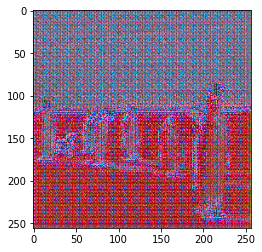

Batch No - 20 Completed with time 1.5729405879974365


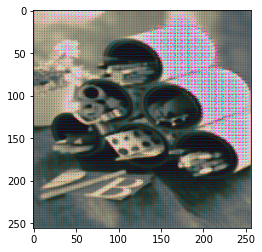

Batch No - 40 Completed with time 1.586970329284668


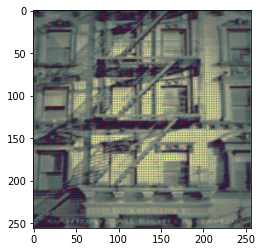

Batch No - 60 Completed with time 1.599825382232666


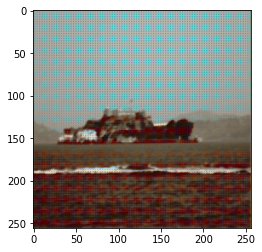

Batch No - 80 Completed with time 1.6153578758239746


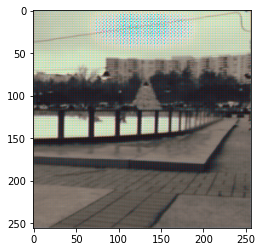

Batch No - 100 Completed with time 1.582024335861206


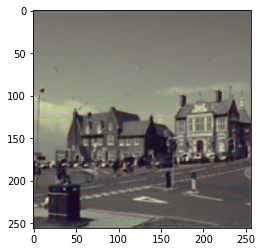

Batch No - 120 Completed with time 1.6103732585906982


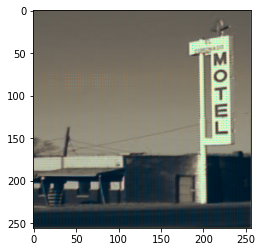

Batch No - 140 Completed with time 1.5784459114074707


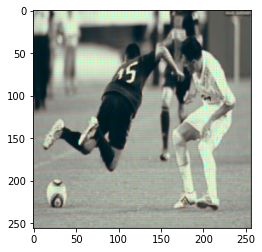

Batch No - 160 Completed with time 1.5907111167907715


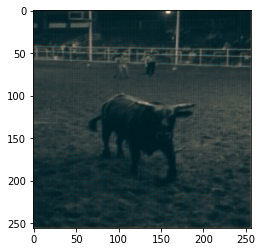

Batch No - 180 Completed with time 1.6191778182983398


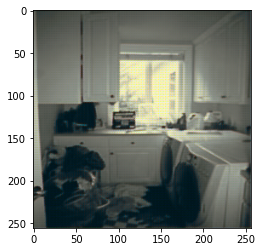

Batch No - 200 Completed with time 1.6195216178894043


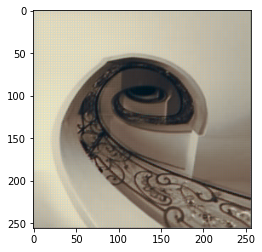

Batch No - 220 Completed with time 1.589881181716919


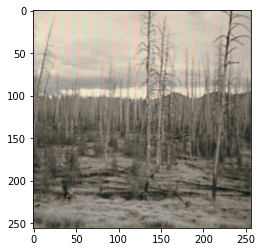

Batch No - 240 Completed with time 1.581385850906372


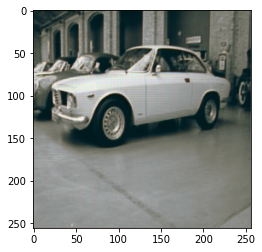

Epoch  1  done
Saving weights as latest_colorize_weights_1


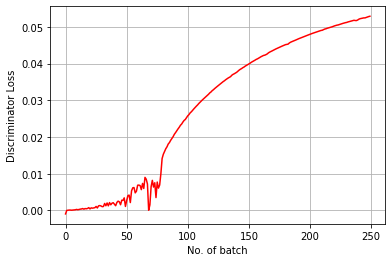

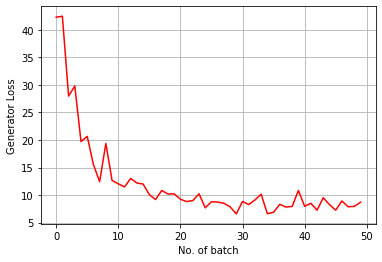

Batch No - 0 Completed with time 3.0359911918640137


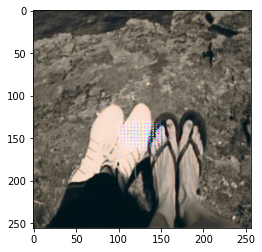

Batch No - 20 Completed with time 1.5891404151916504


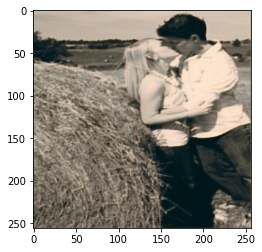

Batch No - 40 Completed with time 1.6309983730316162


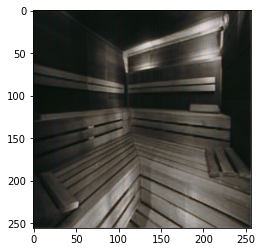

Batch No - 60 Completed with time 1.6049072742462158


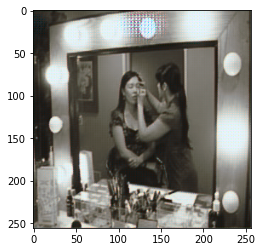

Batch No - 80 Completed with time 1.6003093719482422


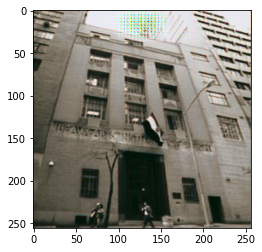

Batch No - 100 Completed with time 1.6239502429962158


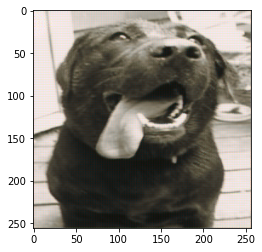

Batch No - 120 Completed with time 1.5993125438690186


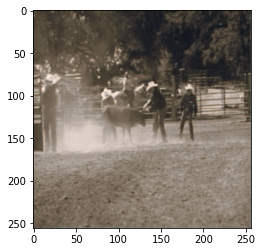

Batch No - 140 Completed with time 1.589803695678711


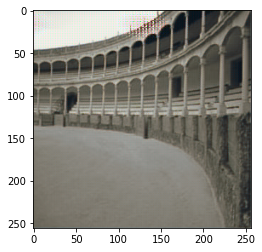

Batch No - 160 Completed with time 1.6120262145996094


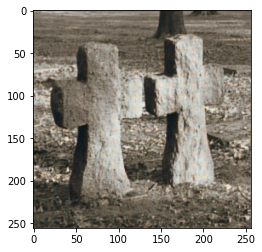

Batch No - 180 Completed with time 1.5955274105072021


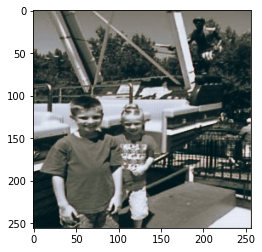

Batch No - 200 Completed with time 1.5886976718902588


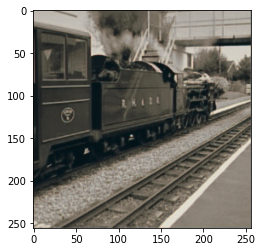

Batch No - 220 Completed with time 1.5804600715637207


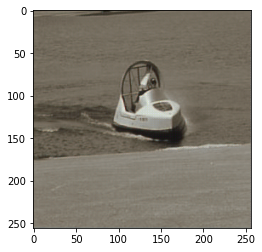

Batch No - 240 Completed with time 1.600128173828125


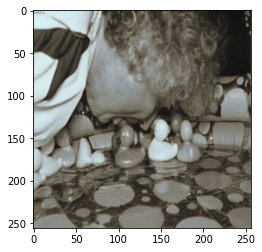

Epoch  2  done
Saving weights as latest_colorize_weights_2


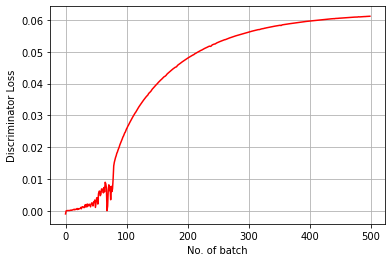

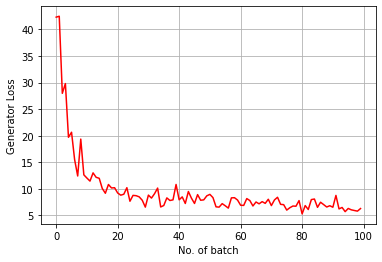

Batch No - 0 Completed with time 3.04898738861084


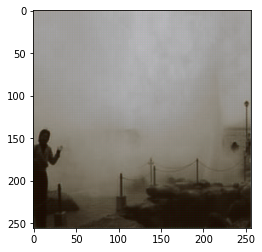

Batch No - 20 Completed with time 1.6060543060302734


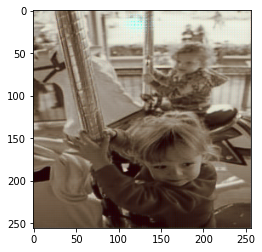

Batch No - 40 Completed with time 1.5909571647644043


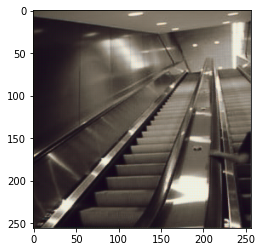

Batch No - 60 Completed with time 1.6093926429748535


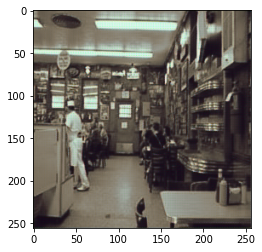

Batch No - 80 Completed with time 1.5913329124450684


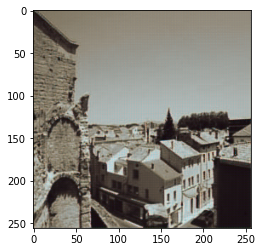

Batch No - 100 Completed with time 1.5844135284423828


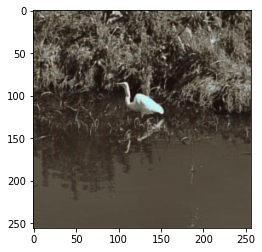

Batch No - 120 Completed with time 1.619950532913208


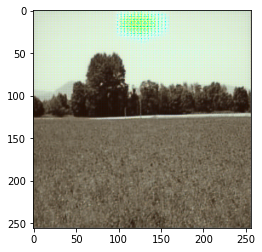

Batch No - 140 Completed with time 1.5928568840026855


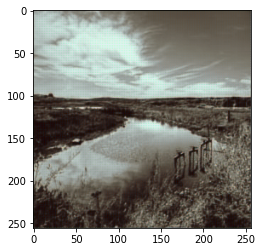

Batch No - 160 Completed with time 1.6298646926879883


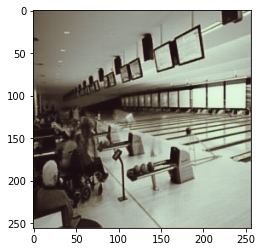

Batch No - 180 Completed with time 1.5906965732574463


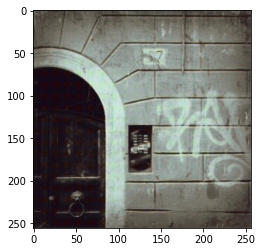

Batch No - 200 Completed with time 1.58884596824646


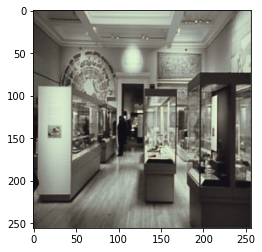

Batch No - 220 Completed with time 1.5756421089172363


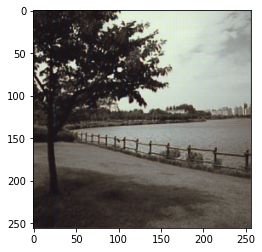

Batch No - 240 Completed with time 1.603499412536621


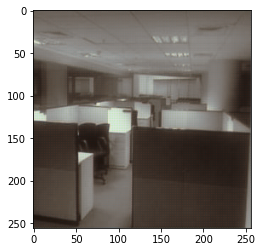

Epoch  3  done
Saving weights as latest_colorize_weights_3


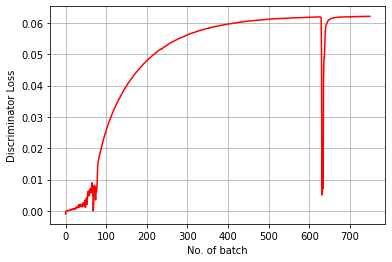

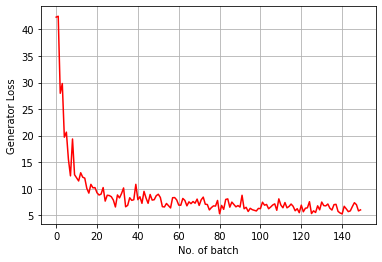

Batch No - 0 Completed with time 3.8235015869140625


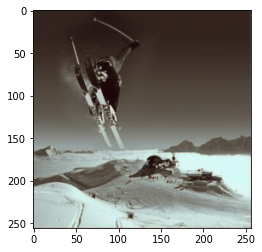

Batch No - 20 Completed with time 1.5978670120239258


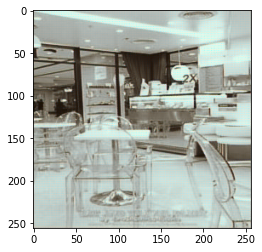

Batch No - 40 Completed with time 1.5814549922943115


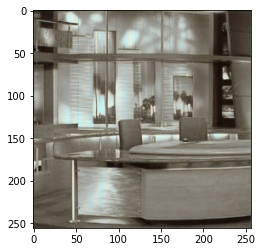

Batch No - 60 Completed with time 1.5954399108886719


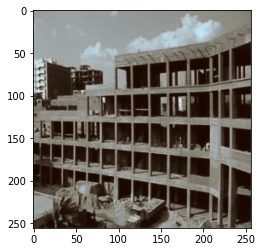

Batch No - 80 Completed with time 1.5843894481658936


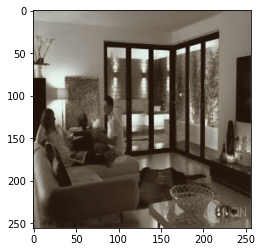

Batch No - 100 Completed with time 1.583503246307373


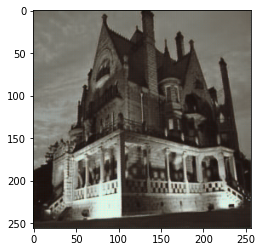

Batch No - 120 Completed with time 1.5861036777496338


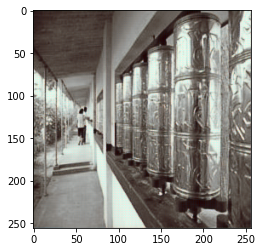

Batch No - 140 Completed with time 1.581587553024292


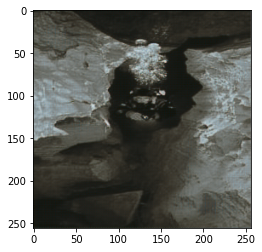

Batch No - 160 Completed with time 1.5963151454925537


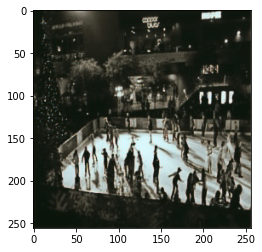

Batch No - 180 Completed with time 1.5981874465942383


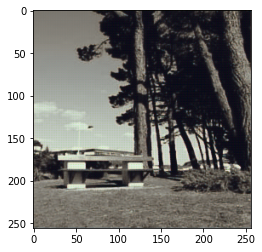

Batch No - 200 Completed with time 1.5917134284973145


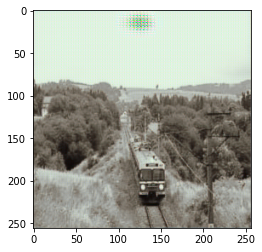

Batch No - 220 Completed with time 1.6383557319641113


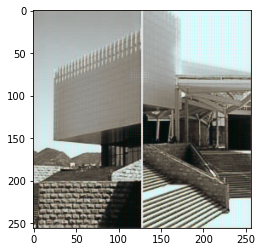

Batch No - 240 Completed with time 1.5984721183776855


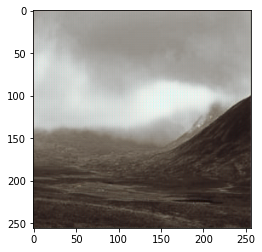

Epoch  4  done
Saving weights as latest_colorize_weights_4


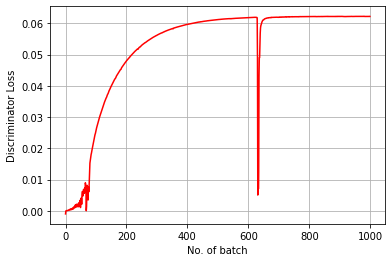

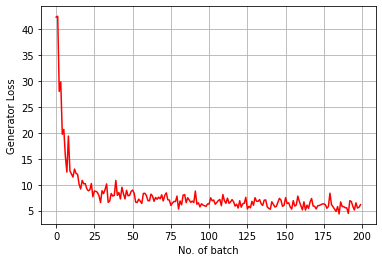

Batch No - 0 Completed with time 3.8455121517181396


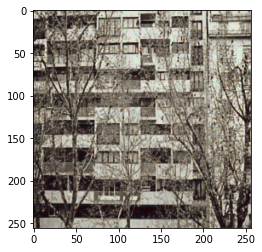

Batch No - 20 Completed with time 1.5651817321777344


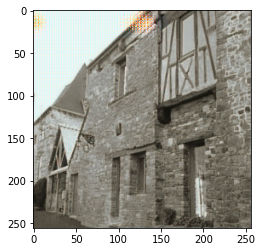

Batch No - 40 Completed with time 1.5770344734191895


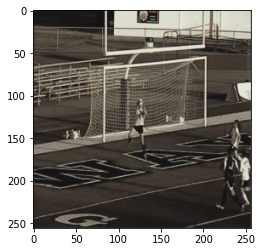

Batch No - 60 Completed with time 1.5495543479919434


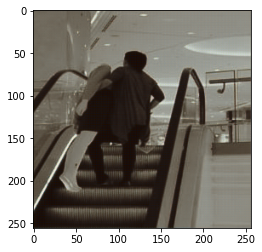

Batch No - 80 Completed with time 1.5627689361572266


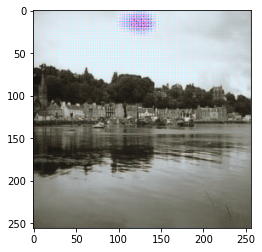

Batch No - 100 Completed with time 1.5450818538665771


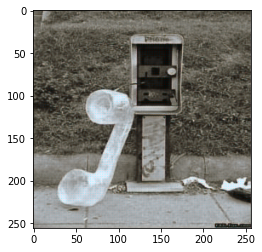

Batch No - 120 Completed with time 1.5455474853515625


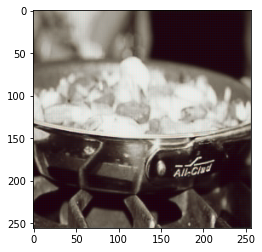

Batch No - 140 Completed with time 1.552616834640503


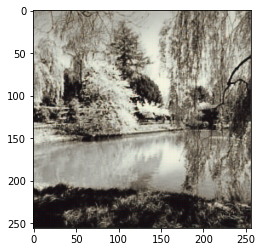

Batch No - 160 Completed with time 1.5610406398773193


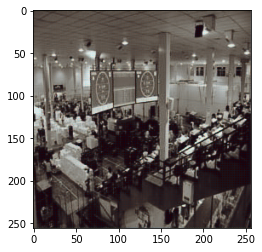

Batch No - 180 Completed with time 1.5544605255126953


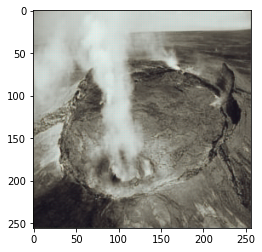

Batch No - 200 Completed with time 1.5656819343566895


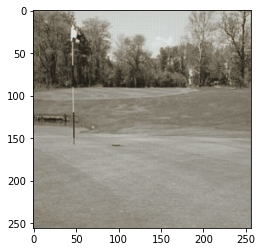

Batch No - 220 Completed with time 1.5665204524993896


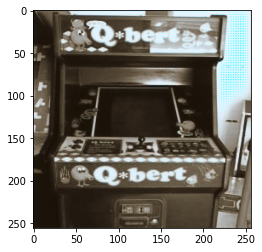

Batch No - 240 Completed with time 1.5933315753936768


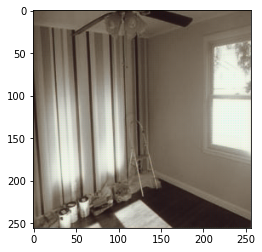

Epoch  5  done
Saving weights as latest_colorize_weights_5


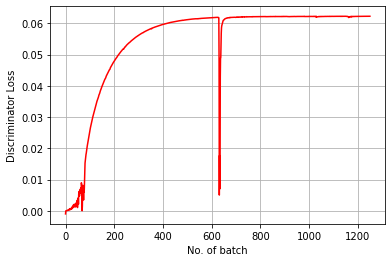

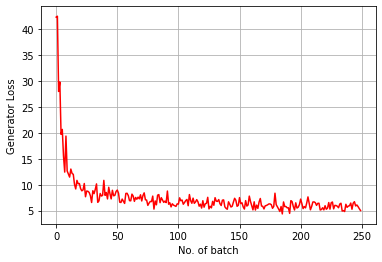

Batch No - 0 Completed with time 3.373262643814087


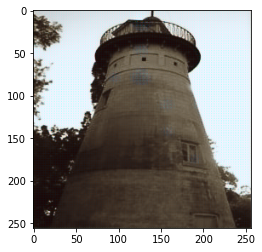

Batch No - 20 Completed with time 1.5687355995178223


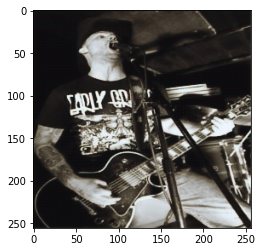

Batch No - 40 Completed with time 1.551694631576538


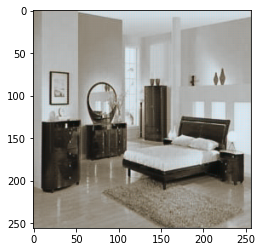

Batch No - 60 Completed with time 1.5500366687774658


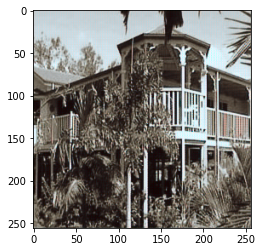

Batch No - 80 Completed with time 1.5694799423217773


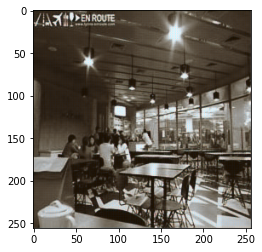

Batch No - 100 Completed with time 1.6039533615112305


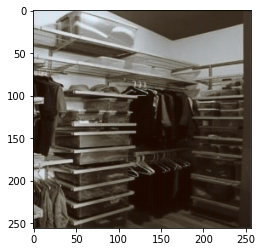

Batch No - 120 Completed with time 1.5505366325378418


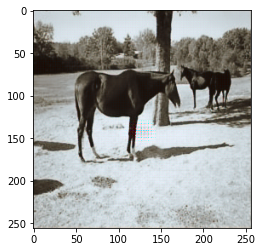

Batch No - 140 Completed with time 1.5890209674835205


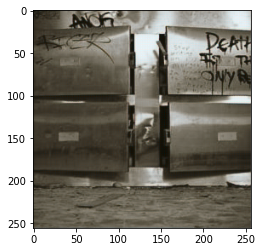

Batch No - 160 Completed with time 1.5911879539489746


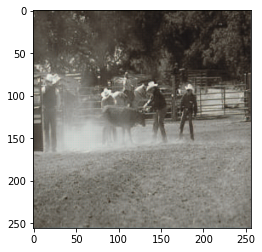

Batch No - 180 Completed with time 1.5687179565429688


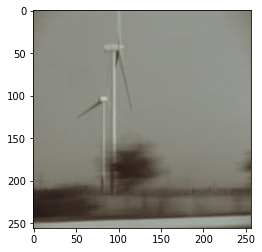

Batch No - 200 Completed with time 1.6311936378479004


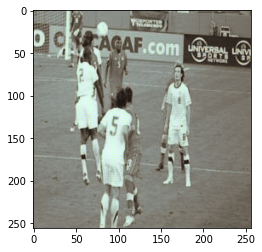

Batch No - 220 Completed with time 1.548335313796997


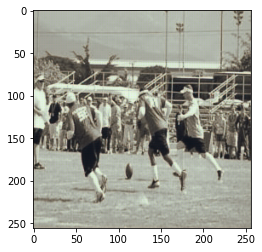

Batch No - 240 Completed with time 1.554004192352295


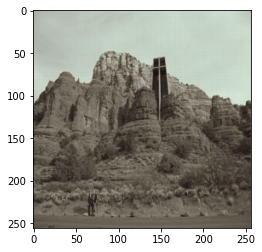

Epoch  6  done
Saving weights as latest_colorize_weights_6


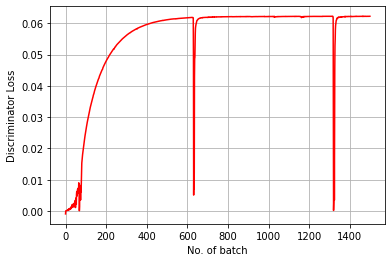

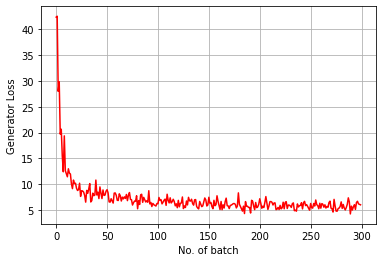

Batch No - 0 Completed with time 3.197890520095825


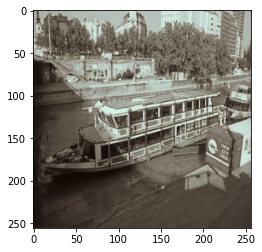

Batch No - 20 Completed with time 1.5692138671875


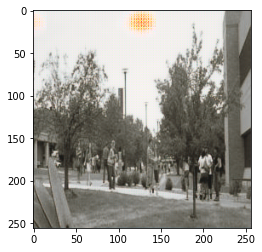

Batch No - 40 Completed with time 1.5350873470306396


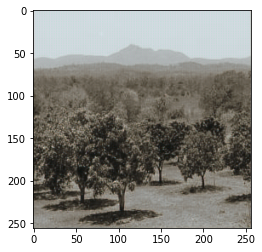

Batch No - 60 Completed with time 1.5676095485687256


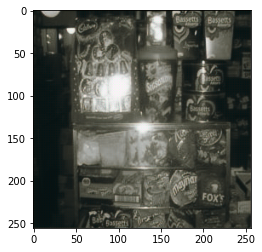

Batch No - 80 Completed with time 1.5792968273162842


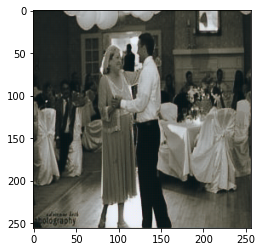

Batch No - 100 Completed with time 1.55953049659729


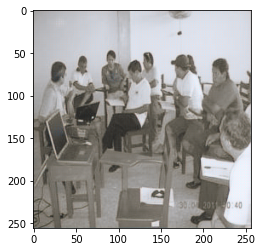

Batch No - 120 Completed with time 1.5435073375701904


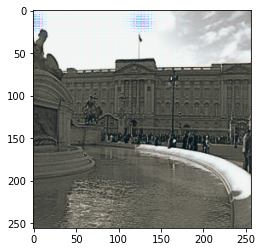

Batch No - 140 Completed with time 1.5406475067138672


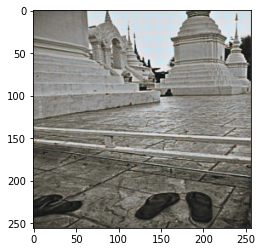

Batch No - 160 Completed with time 1.551016092300415


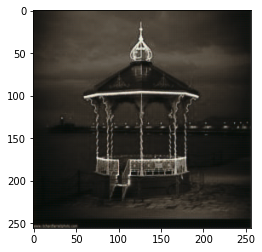

Batch No - 180 Completed with time 1.5652952194213867


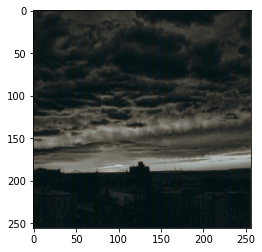

Batch No - 200 Completed with time 1.5938763618469238


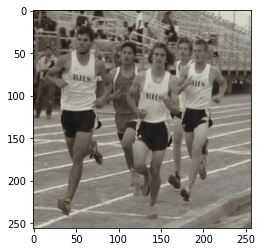

Batch No - 220 Completed with time 1.5886595249176025


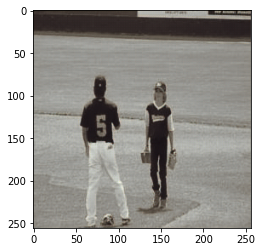

Batch No - 240 Completed with time 1.5705814361572266


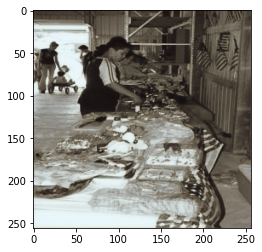

Epoch  7  done
Saving weights as latest_colorize_weights_7


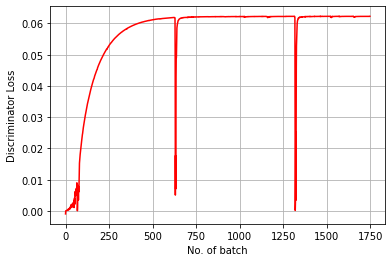

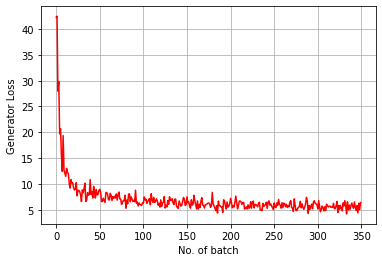

Batch No - 0 Completed with time 3.7466137409210205


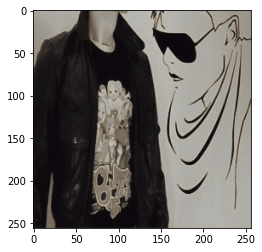

Batch No - 20 Completed with time 1.5546507835388184


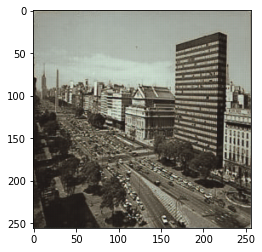

Batch No - 40 Completed with time 1.5623385906219482


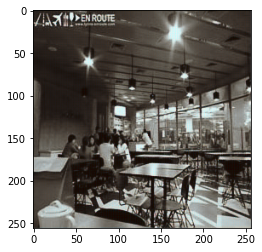

Batch No - 60 Completed with time 1.5882625579833984


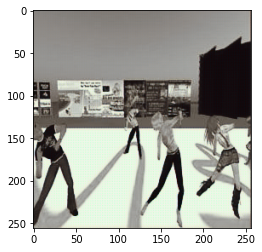

Batch No - 80 Completed with time 1.5586860179901123


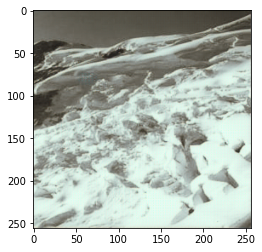

Batch No - 100 Completed with time 2.3988442420959473


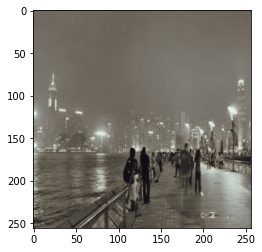

Batch No - 120 Completed with time 1.5525577068328857


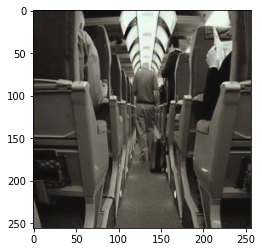

Batch No - 140 Completed with time 1.539113998413086


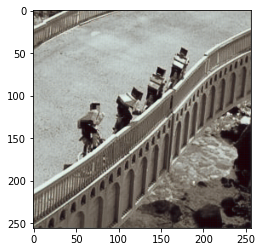

Batch No - 160 Completed with time 1.5713889598846436


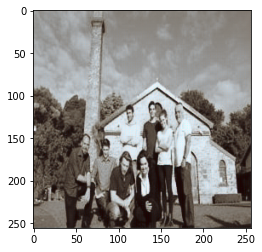

Batch No - 180 Completed with time 1.569007396697998


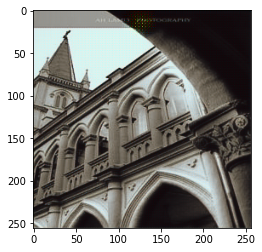

Batch No - 200 Completed with time 1.548431396484375


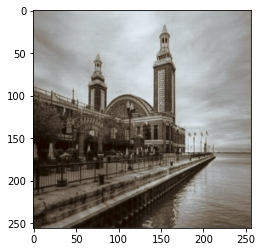

Batch No - 220 Completed with time 1.5582506656646729


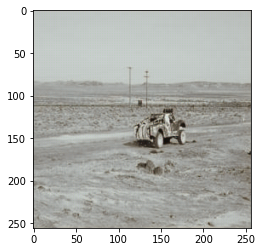

Batch No - 240 Completed with time 1.5634732246398926


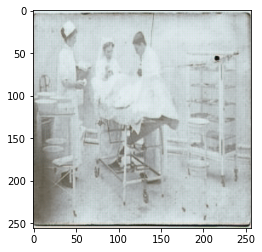

Epoch  8  done
Saving weights as latest_colorize_weights_8


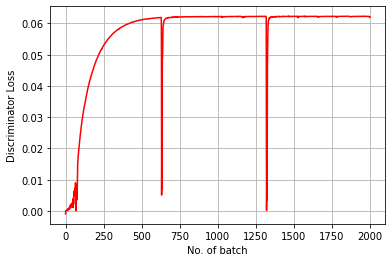

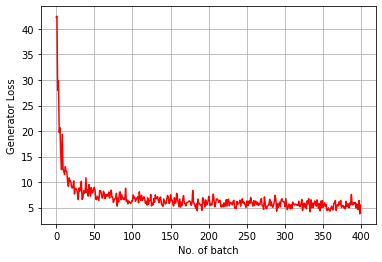

Batch No - 0 Completed with time 3.0415847301483154


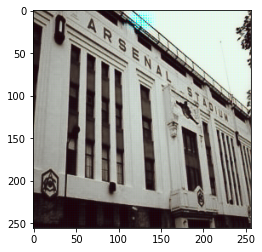

Batch No - 20 Completed with time 1.5584611892700195


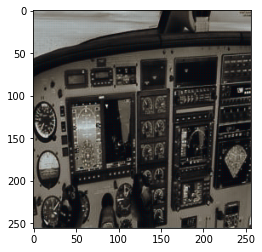

Batch No - 40 Completed with time 1.5521650314331055


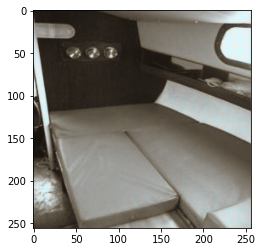

Batch No - 60 Completed with time 1.5687716007232666


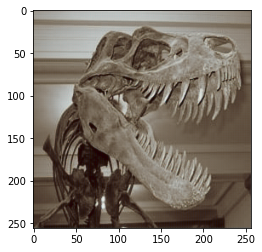

Batch No - 80 Completed with time 1.5765962600708008


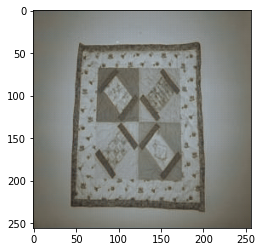

Batch No - 100 Completed with time 1.5589807033538818


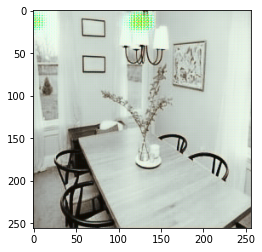

Batch No - 120 Completed with time 1.5607335567474365


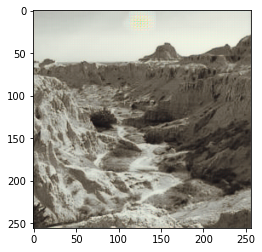

Batch No - 140 Completed with time 1.5733082294464111


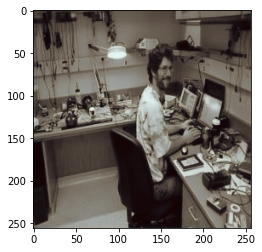

Batch No - 160 Completed with time 1.567819356918335


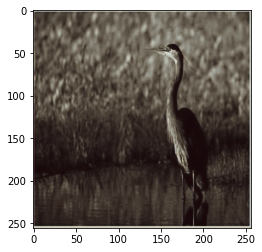

Batch No - 180 Completed with time 1.569995403289795


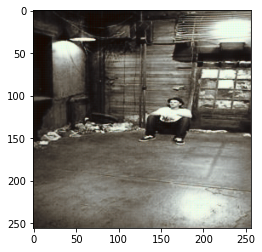

Batch No - 200 Completed with time 1.5728073120117188


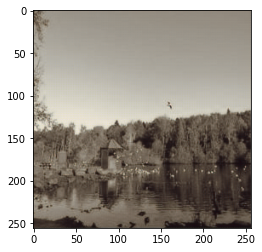

Batch No - 220 Completed with time 1.5523052215576172


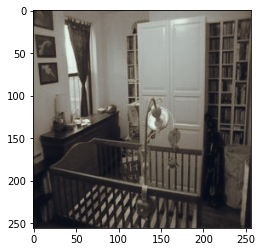

Batch No - 240 Completed with time 1.5592880249023438


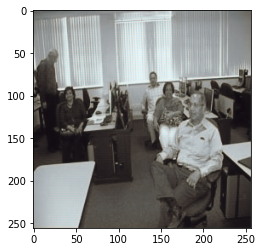

Epoch  9  done
Saving weights as latest_colorize_weights_9


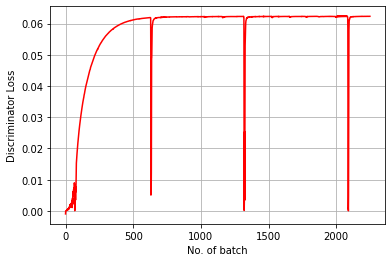

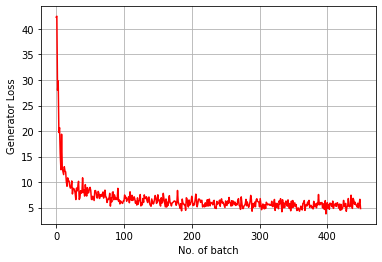

In [20]:
torch.autograd.set_detect_anomaly(True)
step=1
if config.resume:
  step=checkpoint['step']+1
training=True
real_label=0.9
fake_label=0.0
time_last=time.time()

n_critic = 5

while step<config.epoch:
  for i,(lab_imgs,gray_imgs,imgs) in enumerate(train_loader):
      
      lab_imgs=Variable(lab_imgs.cuda().type(dtype))
      gray_imgs=Variable(gray_imgs.cuda().type(dtype))
      imgs=Variable(imgs.cuda().type(dtype))

      fake_data = Gen_Model(gray_imgs).detach()
      real_data = imgs.to(device)
      errorC = train_critic(optimizer_D, real_data, fake_data)
      loss_c.append(errorC)
        
      if (i+1)%n_critic==0:
          fake_data = Gen_Model(gray_imgs)
          L1=nn.L1Loss()
          error_G_L1=L1(fake_data.view(fake_data.size(0),-1),lab_imgs.view(lab_imgs.size(0),-1))
          errorG = train_generator(optimizer_G, fake_data) + config.lamb * error_G_L1
          errorG.backward()
          optimizer_G.step()
          errorG = np.array(errorG.detach().cpu())
          loss_g.append(errorG)
      this_time=time.time()

      if i%20==0:
        print("Batch No -",i,"Completed with time",this_time-time_last)
        with torch.no_grad():
          imfakeshow(fake_data[0])
      time_last=time.time()

  print("Epoch ",step," done")
  state={'step':step,
         'state_dict_G':Gen_Model.state_dict(),
         'state_dict_D':Dis_Model.state_dict(),
         'optimizer_G':optimizer_G.state_dict(),
         'optimizer_D':optimizer_D.state_dict()}
  save_weights(state,step)
  save_loss_hist(loss_c,loss_g)

  plt.plot(np.array(loss_c), 'r')
  plt.xlabel('No. of batch')
  plt.ylabel('Discriminator Loss')
  plt.grid()
  plt.show()

  plt.plot(np.array(loss_g), 'r')
  plt.xlabel('No. of batch')
  plt.ylabel('Generator Loss')
  plt.grid()
  plt.show()
  
  step+=1

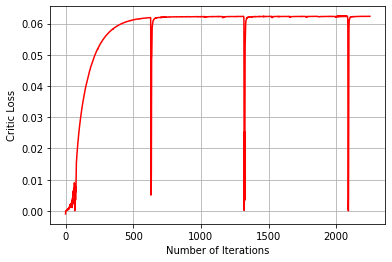

In [21]:
plt.plot(np.array(loss_c), 'r')
plt.ylabel("Critic Loss")
plt.xlabel("Number of Iterations")
plt.grid()

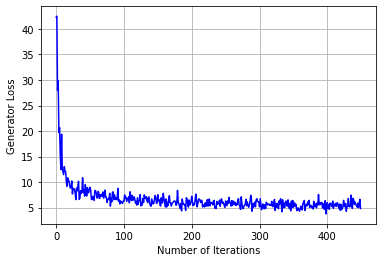

In [22]:
plt.plot(np.array(loss_g), 'b')
plt.ylabel("Generator Loss")
plt.xlabel("Number of Iterations")
plt.grid()

Test your Model

In [24]:
################# Test Time ######################
#test_size = 1000;
model=Generator().to(device)
model.eval()
checkpoint=torch.load(config.save_path)
model.load_state_dict(checkpoint['state_dict_G'])

generated_imgs = []
real_imgs = []
bw_imgs = []
Lab_imgs = []

with torch.no_grad():
    test_data=Places365Loader('test')
    test_loader=DataLoader(test_data,config.batch_size,shuffle=False,collate_fn=test_collate)
    for i,(lab_imgs,gray_imgs,imgs) in enumerate(test_loader):
      lab_imgs=lab_imgs.cuda().type(dtype)
      gray_imgs=gray_imgs.cuda().type(dtype)
      imgs=imgs.cuda().type(dtype)
      fake_img=Gen_Model(gray_imgs)

      fake_img = fake_img.detach().cpu()
      lab_imgs = lab_imgs.detach().cpu()
      gray_imgs = gray_imgs.detach().cpu()
      imgs = imgs.detach().cpu()

      generated_imgs.append(fake_img)
      real_imgs.append(imgs)
      bw_imgs.append(gray_imgs)
      Lab_imgs.append(lab_imgs)

In [25]:
lis_generated_imgs = []
lis_real_imgs = []
lis_bw_imgs = []
lis_lab_imgs = []
for i in range(len(generated_imgs)):
  for j in range(generated_imgs[i].shape[0]):
    lis_generated_imgs.append(np.array(generated_imgs[i])[j])
    lis_real_imgs.append(np.array(real_imgs[i])[j])
    lis_bw_imgs.append(np.array(bw_imgs[i])[j])
    lis_lab_imgs.append(np.array(Lab_imgs[i])[j])

In [26]:
from math import log10, sqrt
from sklearn.metrics import mean_absolute_error
def eval_metric(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    mae = mean_absolute_error(original.reshape((256*3,256)),compressed.reshape((256*3,256)))
    return psnr,mae

In [27]:
PSNR_metric_wgan_gp = []
MAE_metric_wgan_gp = []
for i in range(len(lis_generated_imgs)):
  original = lis_real_imgs[i]
  generated = lis_generated_imgs[i]
  psnr,mae = eval_metric(original,generated)
  PSNR_metric_wgan_gp.append(psnr)
  MAE_metric_wgan_gp.append(mae) 

In [28]:
print('PSNR metric is', sum(PSNR_metric_wgan_gp)/len(PSNR_metric_wgan_gp))
print('MAE metric is', sum(MAE_metric_wgan_gp)/len(MAE_metric_wgan_gp))

PSNR metric is 6.253256340829208
MAE metric is 113.33796592712402


In [29]:
def show_results(i,lis_generated_imgs,lis_real_imgs,lis_bw_imgs):
  print("GrayScale Image - ")
  imgrayshow(torch.tensor(lis_bw_imgs[i]))
  print("Original Image - ")
  imlabshow(torch.tensor(lis_lab_imgs[i]))
  print("Model Output Image - ")
  imfakeshow(torch.tensor(lis_generated_imgs[i]))

GrayScale Image - 


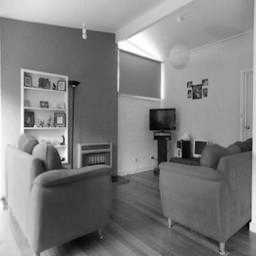

Original Image - 


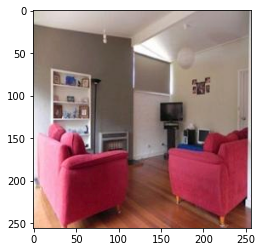

Model Output Image - 


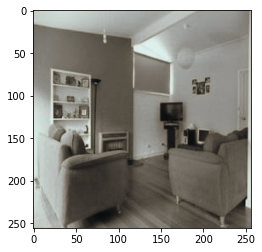

In [39]:
show_results(49,lis_generated_imgs,lis_real_imgs,lis_bw_imgs)

0
GrayScale Image - 


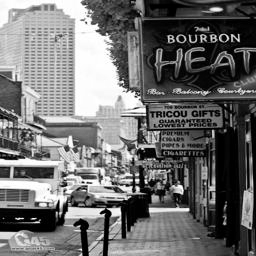

Original Image - 


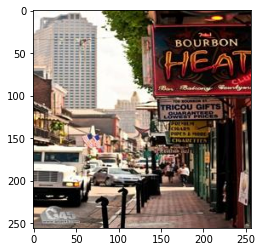

Model Output Image - 


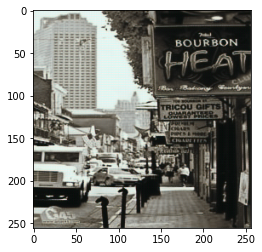

1
GrayScale Image - 


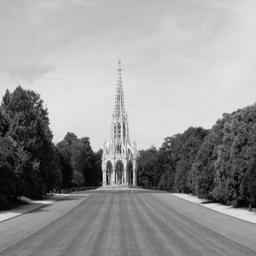

Original Image - 


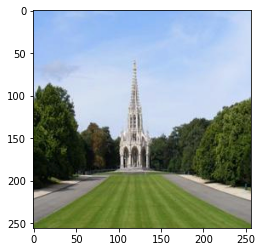

Model Output Image - 


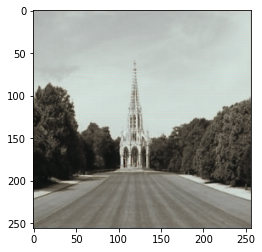

2
GrayScale Image - 


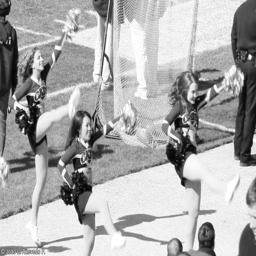

Original Image - 


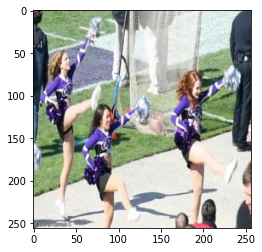

Model Output Image - 


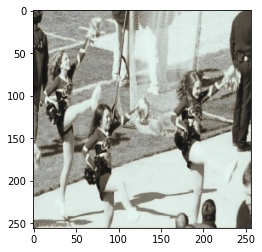

3
GrayScale Image - 


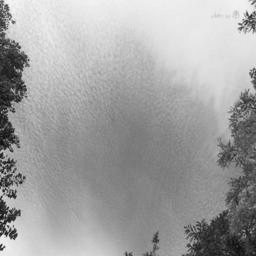

Original Image - 


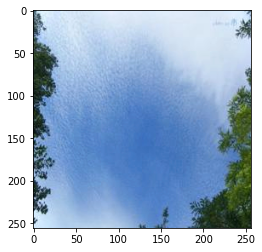

Model Output Image - 


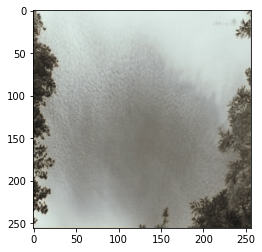

4
GrayScale Image - 


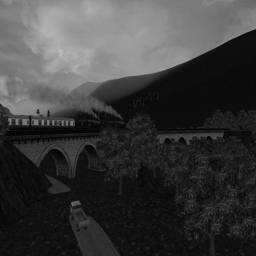

Original Image - 


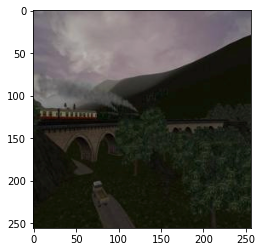

Model Output Image - 


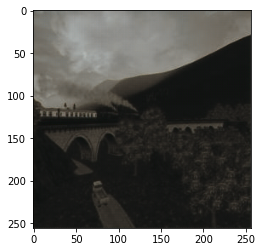

5
GrayScale Image - 


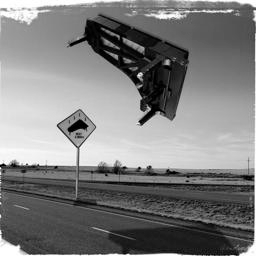

Original Image - 


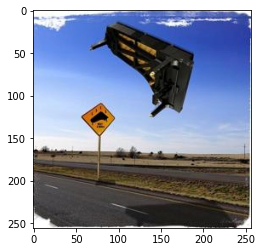

Model Output Image - 


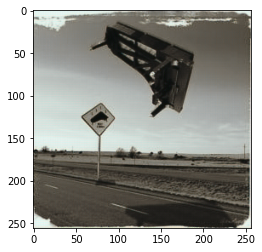

6
GrayScale Image - 


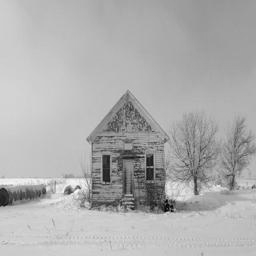

Original Image - 


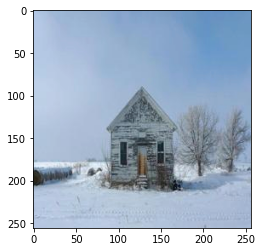

Model Output Image - 


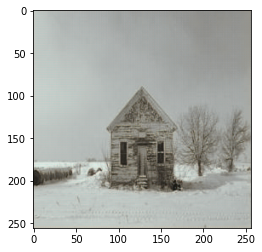

7
GrayScale Image - 


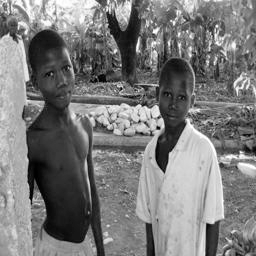

Original Image - 


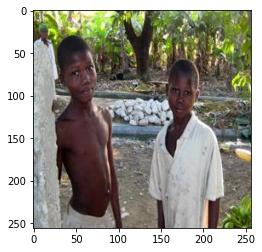

Model Output Image - 


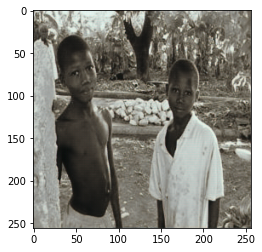

8
GrayScale Image - 


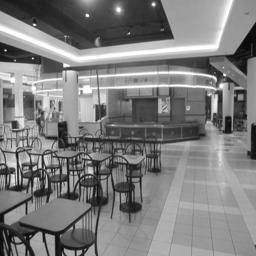

Original Image - 


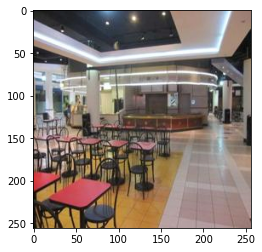

Model Output Image - 


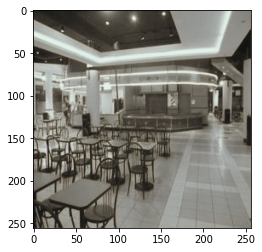

9
GrayScale Image - 


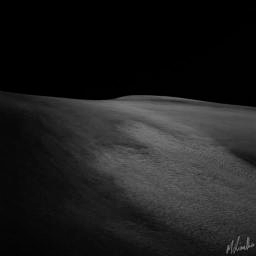

Original Image - 


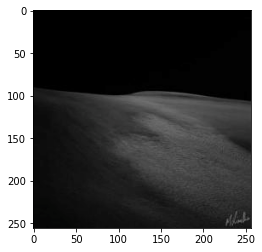

Model Output Image - 


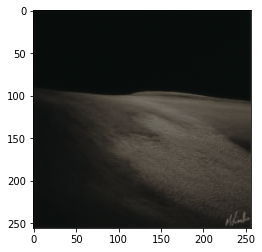

10
GrayScale Image - 


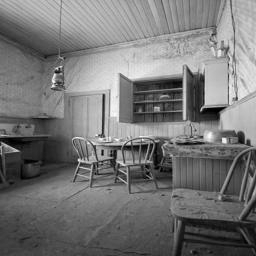

Original Image - 


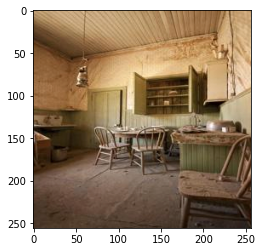

Model Output Image - 


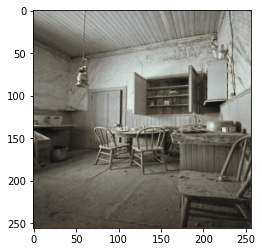

11
GrayScale Image - 


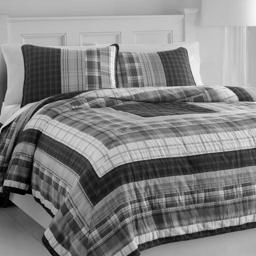

Original Image - 


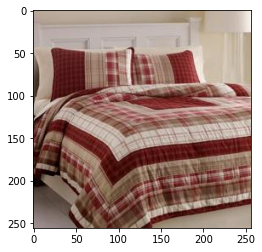

Model Output Image - 


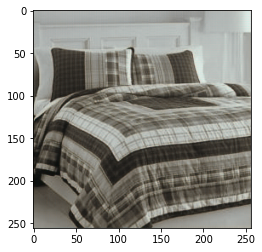

12
GrayScale Image - 


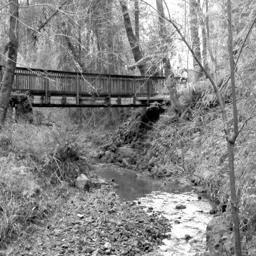

Original Image - 


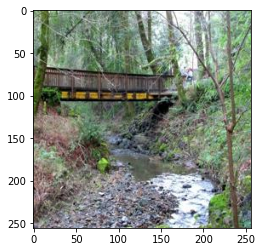

Model Output Image - 


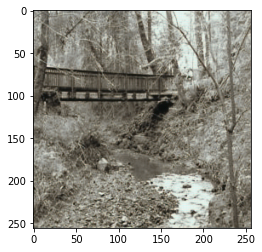

13
GrayScale Image - 


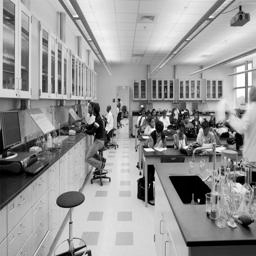

Original Image - 


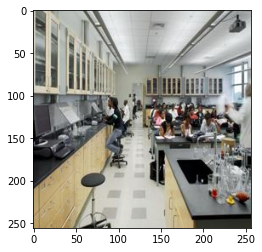

Model Output Image - 


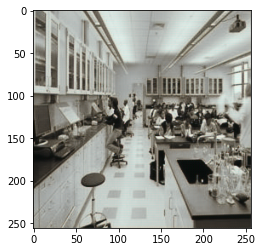

14
GrayScale Image - 


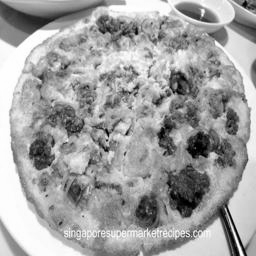

Original Image - 


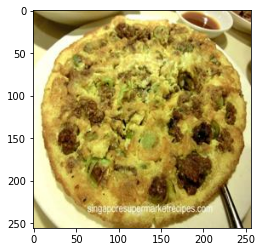

Model Output Image - 


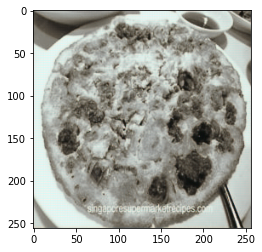

15
GrayScale Image - 


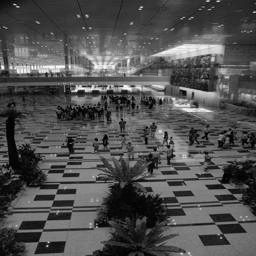

Original Image - 


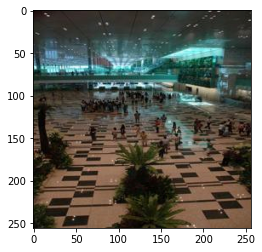

Model Output Image - 


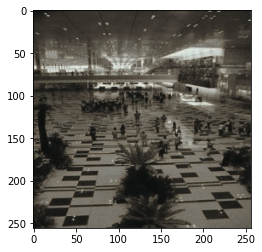

16
GrayScale Image - 


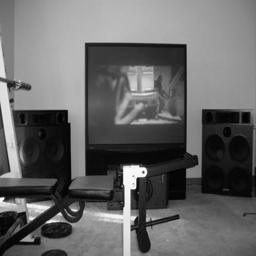

Original Image - 


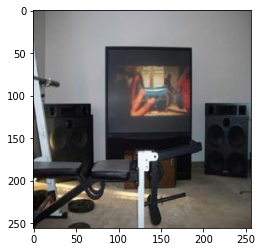

Model Output Image - 


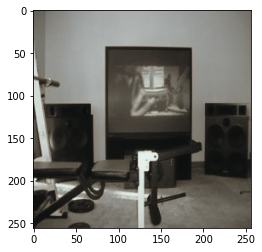

17
GrayScale Image - 


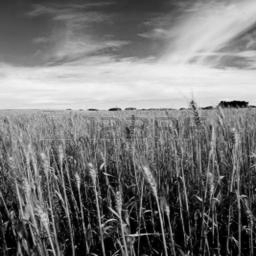

Original Image - 


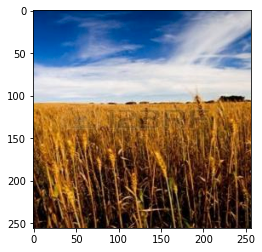

Model Output Image - 


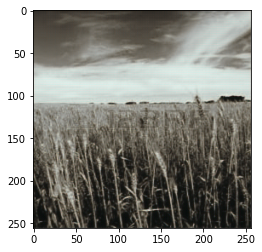

18
GrayScale Image - 


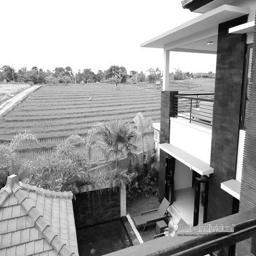

Original Image - 


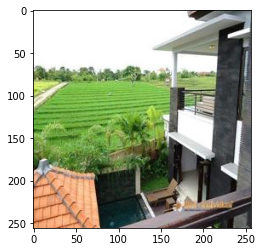

Model Output Image - 


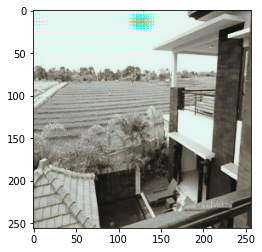

19
GrayScale Image - 


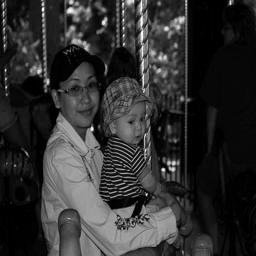

Original Image - 


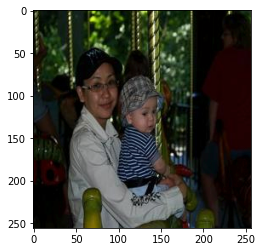

Model Output Image - 


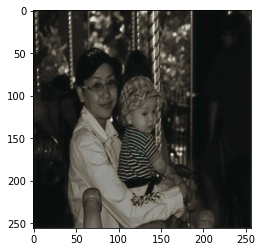

20
GrayScale Image - 


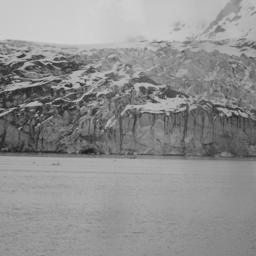

Original Image - 


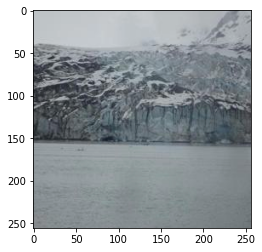

Model Output Image - 


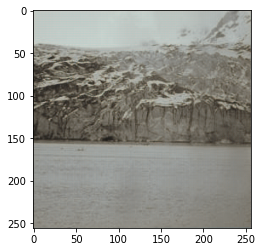

21
GrayScale Image - 


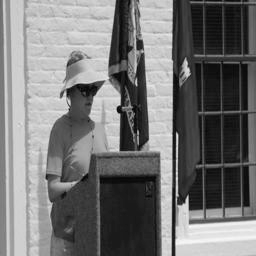

Original Image - 


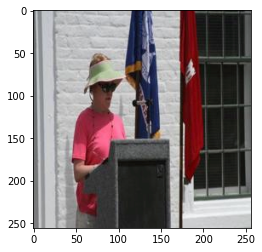

Model Output Image - 


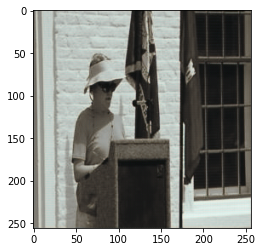

22
GrayScale Image - 


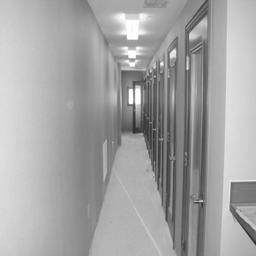

Original Image - 


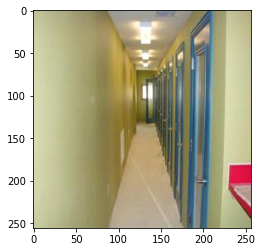

Model Output Image - 


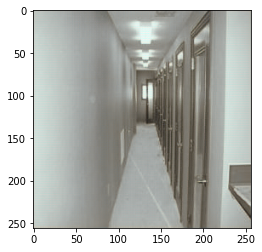

23
GrayScale Image - 


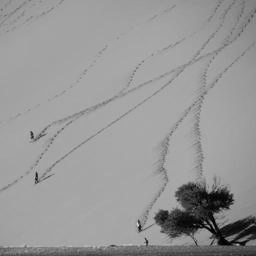

Original Image - 


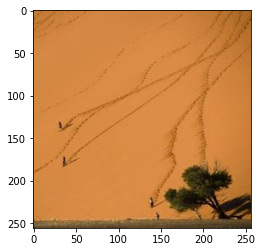

Model Output Image - 


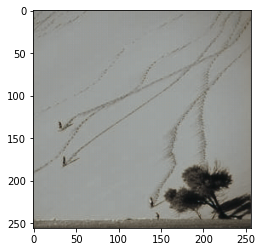

24
GrayScale Image - 


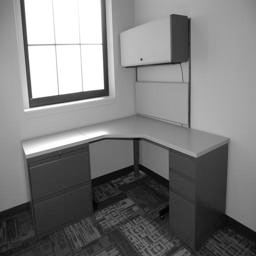

Original Image - 


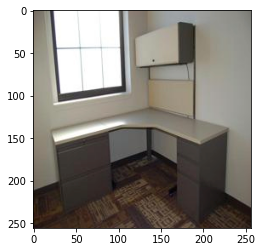

Model Output Image - 


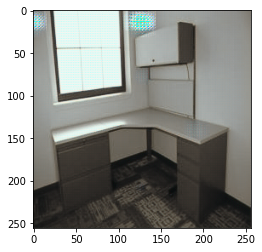

25
GrayScale Image - 


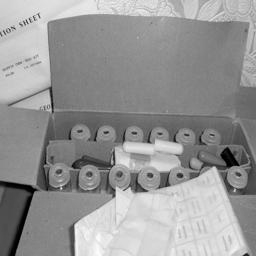

Original Image - 


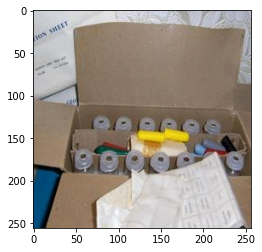

Model Output Image - 


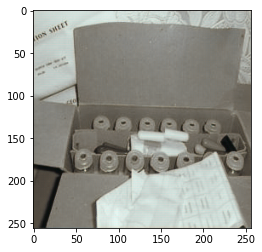

26
GrayScale Image - 


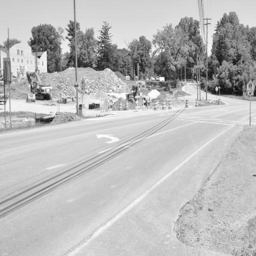

Original Image - 


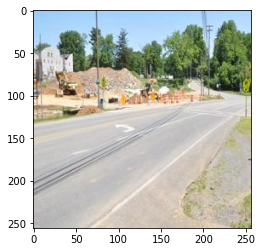

Model Output Image - 


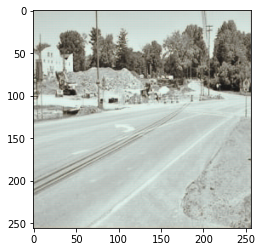

27
GrayScale Image - 


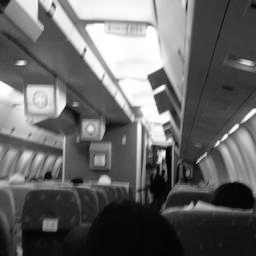

Original Image - 


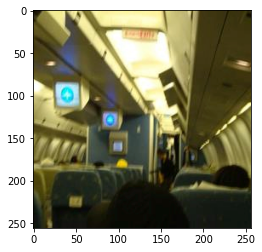

Model Output Image - 


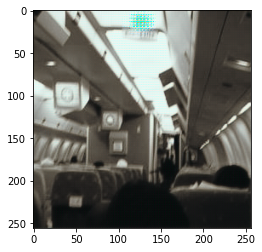

28
GrayScale Image - 


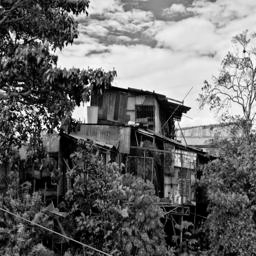

Original Image - 


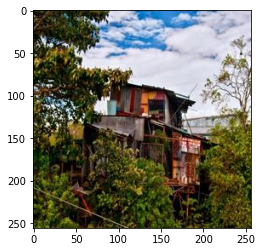

Model Output Image - 


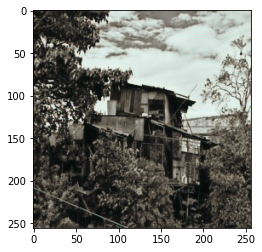

29
GrayScale Image - 


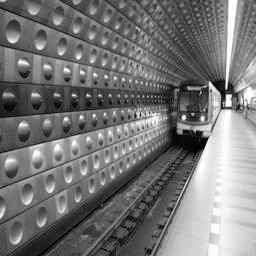

Original Image - 


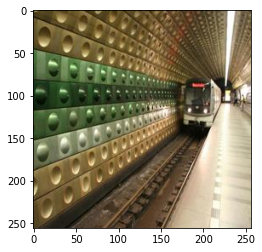

Model Output Image - 


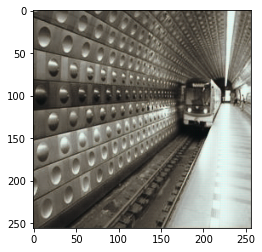

30
GrayScale Image - 


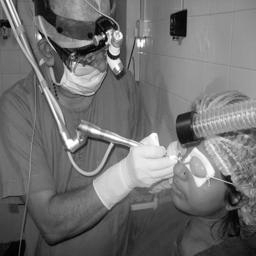

Original Image - 


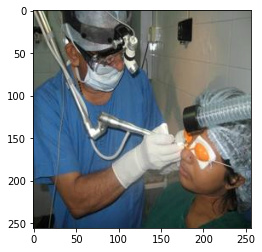

Model Output Image - 


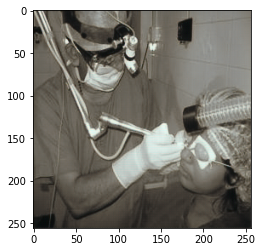

31
GrayScale Image - 


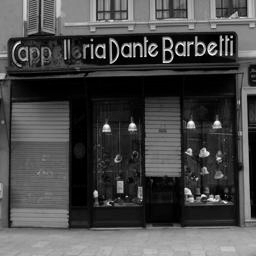

Original Image - 


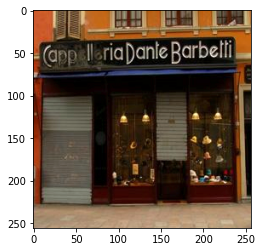

Model Output Image - 


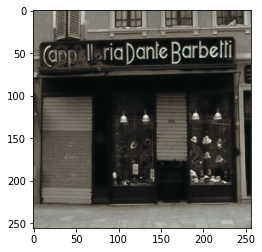

32
GrayScale Image - 


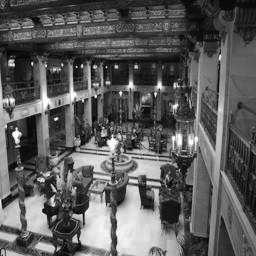

Original Image - 


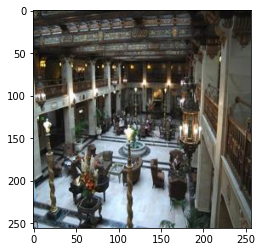

Model Output Image - 


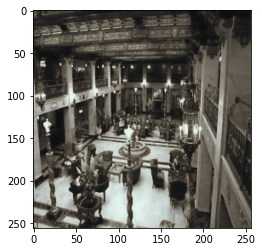

33
GrayScale Image - 


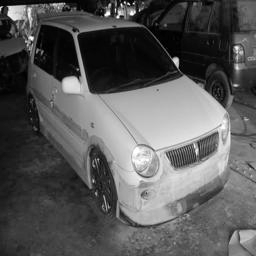

Original Image - 


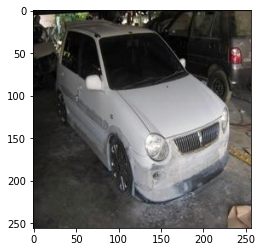

Model Output Image - 


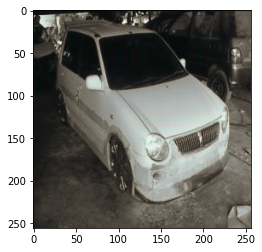

34
GrayScale Image - 


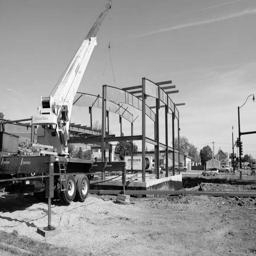

Original Image - 


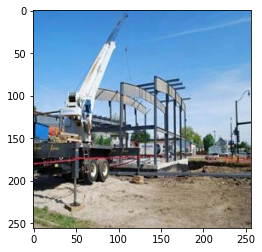

Model Output Image - 


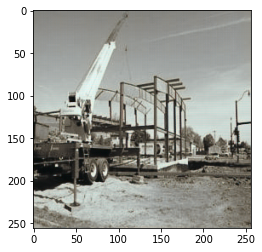

35
GrayScale Image - 


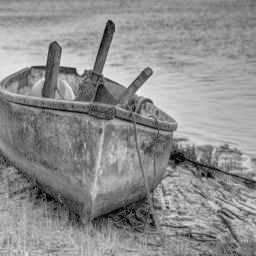

Original Image - 


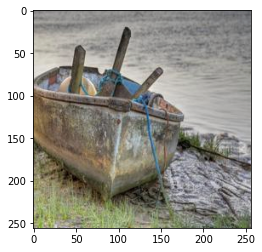

Model Output Image - 


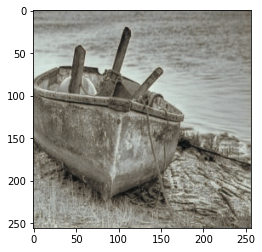

36
GrayScale Image - 


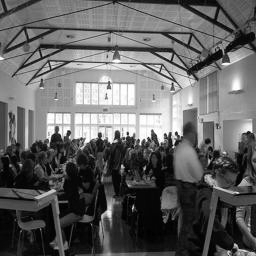

Original Image - 


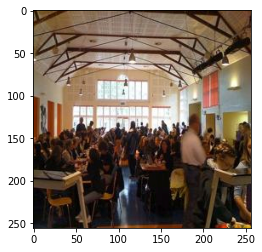

Model Output Image - 


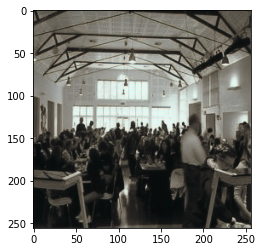

37
GrayScale Image - 


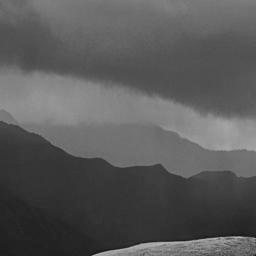

Original Image - 


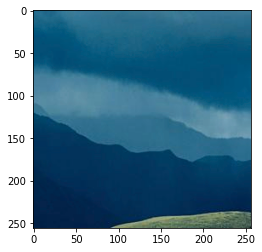

Model Output Image - 


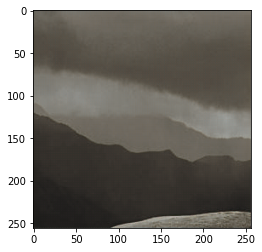

38
GrayScale Image - 


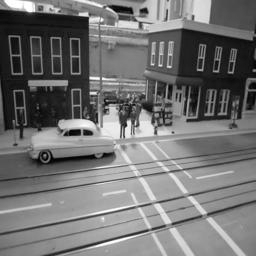

Original Image - 


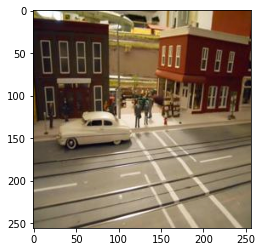

Model Output Image - 


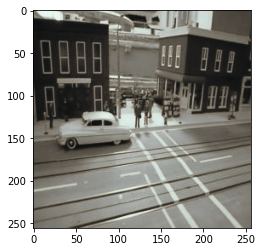

39
GrayScale Image - 


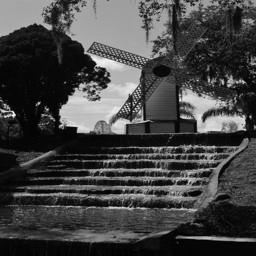

Original Image - 


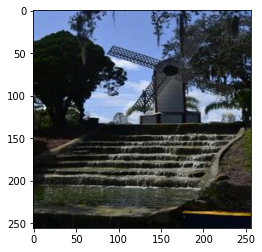

Model Output Image - 


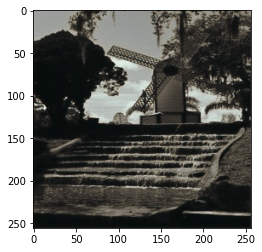

40
GrayScale Image - 


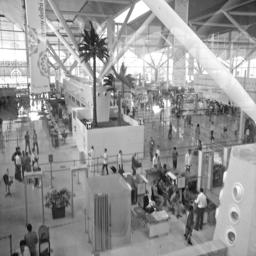

Original Image - 


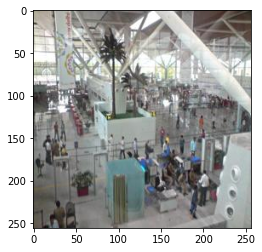

Model Output Image - 


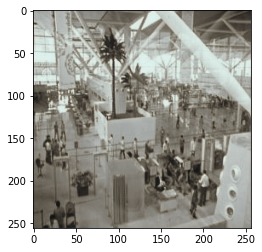

41
GrayScale Image - 


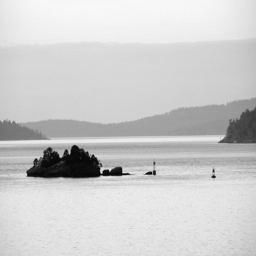

Original Image - 


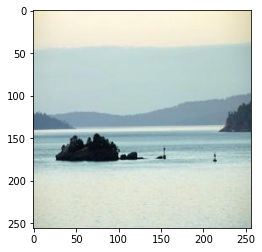

Model Output Image - 


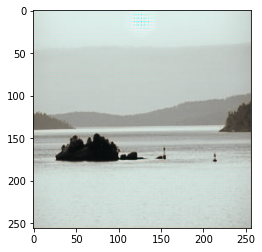

42
GrayScale Image - 


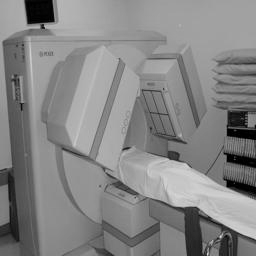

Original Image - 


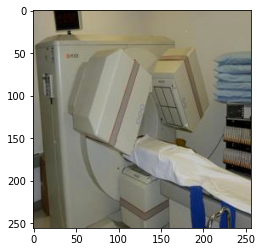

Model Output Image - 


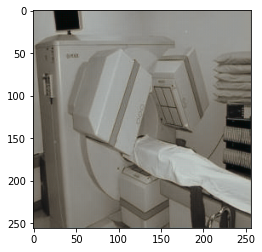

43
GrayScale Image - 


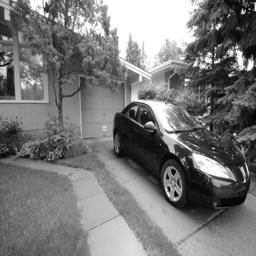

Original Image - 


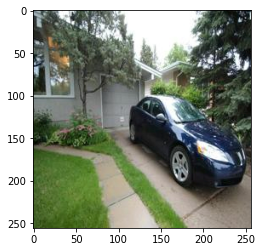

Model Output Image - 


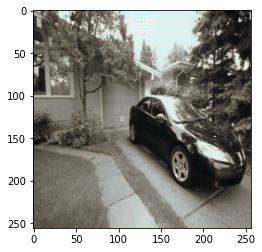

44
GrayScale Image - 


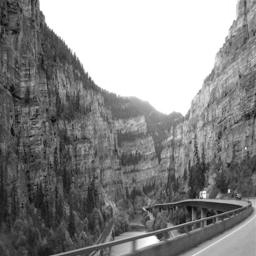

Original Image - 


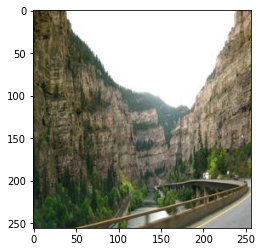

Model Output Image - 


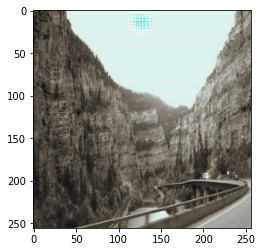

45
GrayScale Image - 


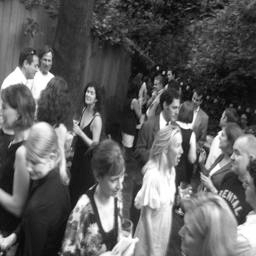

Original Image - 


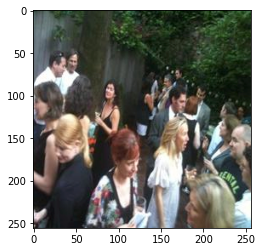

Model Output Image - 


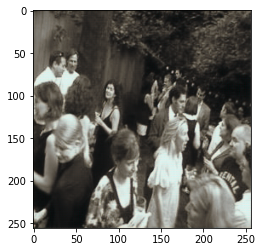

46
GrayScale Image - 


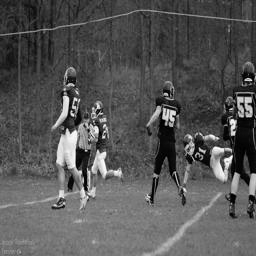

Original Image - 


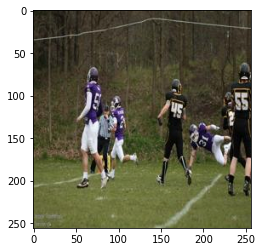

Model Output Image - 


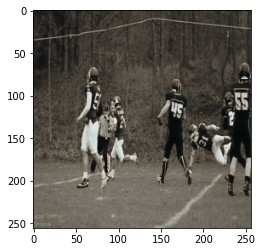

47
GrayScale Image - 


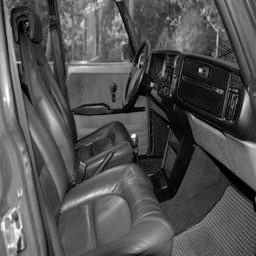

Original Image - 


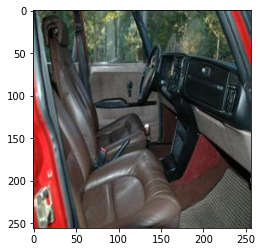

Model Output Image - 


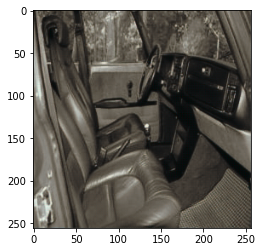

48
GrayScale Image - 


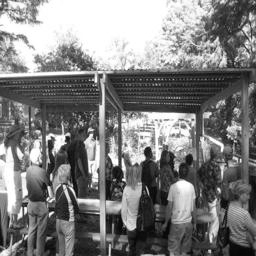

Original Image - 


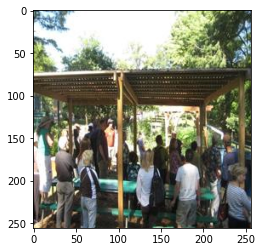

Model Output Image - 


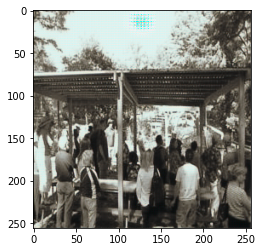

In [36]:
for i in range(49): 
  print(i)
  show_results(i, lis_generated_imgs,lis_real_imgs,lis_bw_imgs)